<a href="https://www.kaggle.com/code/ayushs9020/understanding-the-competition-rsna?scriptVersionId=138150425" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

# <p style="font-family:JetBrains Mono; font-weight:bold; letter-spacing: 2px; color:#BC13FE; font-size:140%; text-align:left;padding: 0px; border-bottom: 3px solid #BC13FE">RSNA : RadioLogical Society of North America </p>

In [1]:
import warnings
warnings.filterwarnings("ignore")

<div style="border-radius:10px; border:#BC13FE solid; padding: 15px; background-color: #F3f9ed; font-size:100%; text-align:left">

The $RSNA$ $2023$ $Abdominal$ $Trauma$ $Detection$ competition is a `machine learning challenge` that aims to `develop algorithms` to `detect abdominal trauma` in $Computed$ $Tomography$ $(CT)$ images. The competition is hosted by the $Radiological$ $Society$ of $North$ $America$ $(RSNA)$ 
    
I couldnt find a good meme related to $RSNA$, so here is $Lightning$ $McQueen$ to cheer $($ $Ka$ $Choww$ $)$
    
<img src = "https://media2.giphy.com/media/v1.Y2lkPTc5MGI3NjExdHUxOHhmNm9zY25jejFzYnBjNHZpdjY1eG10NWRnZXZtcmF1Znk1MSZlcD12MV9naWZzX3NlYXJjaCZjdD1n/B1CrvUCoMxhy8/giphy.gif" width = 300>

Thanks to **[Theo Viel](https://www.kaggle.com/theoviel)** for providing small chunks of data to experiment 
    
$KUDOS$ $!!!$

# <p style="font-family:JetBrains Mono; font-weight:bold; letter-spacing: 2px; color:#21FC0D; font-size:140%; text-align:left;padding: 0px; border-bottom: 3px solid #21FC0D">1 | Data 📊</p>

In [2]:
import pandas as pd 
import pydicom

<div style="border-radius:10px; border:#21FC0D solid; padding: 15px; background-color: #F3f9ed; font-size:100%; text-align:left">
    
Our main data is situated in a `CSV` file $--->$ `train.csv` 

In [3]:
train_csv = pd.read_csv("/kaggle/input/rsna-2023-abdominal-trauma-detection/train.csv")
print(train_csv.shape)
train_csv.head()

(3147, 15)


,patient_id,bowel_healthy,bowel_injury,extravasation_healthy,extravasation_injury,kidney_healthy,kidney_low,kidney_high,liver_healthy,liver_low,liver_high,spleen_healthy,spleen_low,spleen_high,any_injury
0,10004,1,0,0,1,0,1,0,1,0,0,0,0,1,1
1,10005,1,0,1,0,1,0,0,1,0,0,1,0,0,0
2,10007,1,0,1,0,1,0,0,1,0,0,1,0,0,0
3,10026,1,0,1,0,1,0,0,1,0,0,1,0,0,0
4,10051,1,0,1,0,1,0,0,1,0,0,0,1,0,1


<div style="border-radius:10px; border:#21FC0D solid; padding: 15px; background-color: #F3f9ed; font-size:100%; text-align:left">

This csv file contains the `patient_id` and further explanatory columns 

* $Patient$ $ID$ `patient_id` - THis column contains the ids of $3,147$ patients.

Further columns denote what symptons were shown by the specific patient. We can use the `patient_id` to get information from `train_images` Folder.

$Train$ $Images$ is a big $3$ $level$ nested - directory, contianing images for the specific patient . There are different folders in the Direcotry that denote the `patient_id`

The `images` are `labeled` with the `presence` or `absence of abdominal trauma`, as well as the `location of any injuries`. The data is provided in `DICOM` format, which is a standard format for medical images.
    
The type of data in the competition dataset is $CT$ images of `patients with abdominal trauma`. The images are labeled with the `presence`/`absence` of `abdominal trauma`, as well as the `location of any injuries`. The data is provided in `DICOM` `format`, which is a standard format for medical images.

We can read the `DCIM` file through `pydicom`

In [4]:
image_file = "/kaggle/input/rsna-2023-abdominal-trauma-detection/train_images/10004/21057/1001.dcm"
ds = pydicom.read_file(image_file)

ds

Dataset.file_meta -------------------------------
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: CT Image Storage
(0002, 0003) Media Storage SOP Instance UID      UI: 1.2.123.12345.1.2.3.10004.1.1001
(0002, 0010) Transfer Syntax UID                 UI: RLE Lossless
(0002, 0012) Implementation Class UID            UI: 1.2.3.123456.4.5.1234.1.12.0
(0002, 0013) Implementation Version Name         SH: 'PYDICOM 2.4.0'
-------------------------------------------------
(0008, 0018) SOP Instance UID                    UI: 1.2.123.12345.1.2.3.10004.1.1001
(0008, 0023) Content Date                        DA: '20230721'
(0008, 0033) Content Time                        TM: '232531.439438'
(0010, 0020) Patient ID                          LO: '10004'
(0018, 0050) Slice Thickness                     DS: '1.0'
(0018, 0060) KVP                                 DS: '90.0'
(0018, 5100) Patient Position                    CS: 'HFS'
(002

# <p style="font-family:JetBrains Mono; font-weight:bold; letter-spacing: 2px; color:#FFF700; font-size:140%; text-align:left;padding: 0px; border-bottom: 3px solid #FFF700">2 | Visualization 📊</p>

In [5]:
import numpy as np
import tqdm

import matplotlib.pyplot as plt
import matplotlib.animation as animation
import seaborn as sns

from glob import glob
from IPython.display import HTML

<div style="border-radius:10px; border:#FFF700 solid; padding: 15px; background-color: #F3f9ed; font-size:100%; text-align:left">

Thanks to **[Yuanjian Li](https://www.kaggle.com/yuanjianli)=>[EDA with Animation BeginnerFriendly](https://www.kaggle.com/code/yuanjianli/eda-with-animation-beginnerfriendly/comments)/[Jocelyn Dumlao
](https://www.kaggle.com/jocelyndumlao)=>[Unleashing the Healing Potential: Abdominal Trauma](https://www.kaggle.com/code/jocelyndumlao/unleashing-the-healing-potential-abdominal-trauma)** for providing great $CSV-EDA$ Do checkout

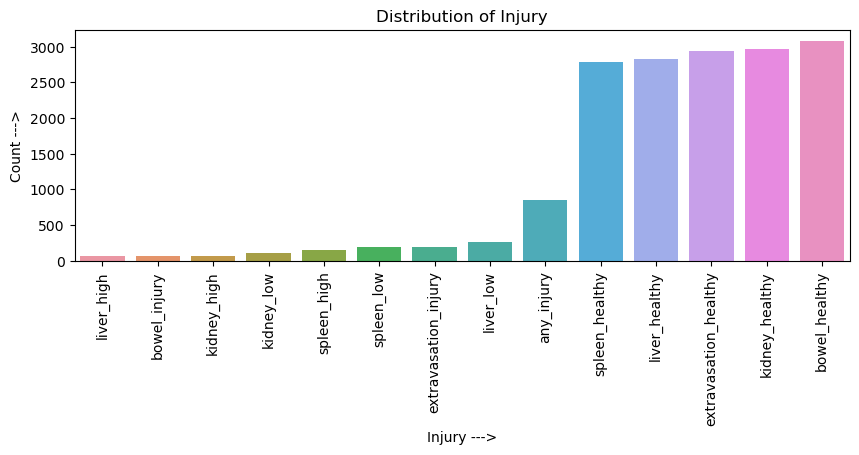

In [6]:
organ_columns = ['bowel', 'extravasation', 'kidney', 'liver', 'spleen']

organ_counts = pd.DataFrame()
organ_counts['Organ'] = train_csv.columns[1:]
organ_counts["count"] = [0 for _ in range(organ_counts.shape[0])]
for index , column in enumerate(train_csv.columns[1:]):
    organ_counts['count'][index] = train_csv[column].sum()
    
plt.figure(figsize=(10, 3))
sns.barplot(data=organ_counts.sort_values(by=['count']), x='Organ', y='count')
plt.xticks(rotation=90)
plt.title("Distribution of Injury")
plt.xlabel("Injury --->")
plt.ylabel("Count --->")
plt.show()

<div style="border-radius:10px; border:#FFF700 solid; padding: 15px; background-color: #F3f9ed; font-size:100%; text-align:left">

Thanks to **[Franklin Shih0617](https://www.kaggle.com/franklinshih0617)=>[RSNA Abdominal Trauma Detect EDA animation](https://www.kaggle.com/code/franklinshih0617/rsna-abdominal-trauma-detect-eda-animation)** for providing great $Animations$. Do checkout

100%|██████████| 1022/1022 [00:23<00:00, 43.41it/s]


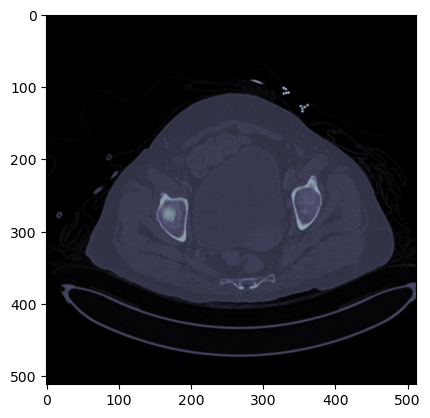

In [7]:
sample_files = sorted(
    glob('/kaggle/input/rsna-2023-abdominal-trauma-detection/train_images/10004/21057/*.dcm')
)

sample_vid = [pydicom.dcmread(file).pixel_array for file in tqdm.tqdm(sample_files , total = len(sample_files))]

fig, ax = plt.subplots()
im = ax.imshow(sample_vid[0], cmap=plt.cm.bone)

update = lambda i : im.set_array(sample_vid[i])

ani = animation.FuncAnimation(fig, update, frames=range(len(sample_vid)), repeat=True)

HTML(ani.to_jshtml())

# <p style="font-family:JetBrains Mono; font-weight:bold; letter-spacing: 2px; color:#00FF00; font-size:140%; text-align:left;padding: 0px; border-bottom: 3px solid #00FF00">3 | TO DO LIST 📝</p>

<div style="border-radius:10px; border:#00FF00 solid; padding: 15px; background-color: #F3f9ed; font-size:100%; text-align:left">
    
* $TO$ $DO$ $LIST$ $1$ $:$ $VIUSALIZE$ $THE$ $DATA$ $MORE$
* $TO$ $DO$ $LIST$ $2$ $:$ $MAKE$ $A$ $PYTORCH$ $DATALOADER$

# <p style="font-family:JetBrains Mono; font-weight:bold; letter-spacing: 2px; color:#87CEEB; font-size:140%; text-align:left;padding: 0px; border-bottom: 3px solid #87CEEB">4 | Ending ☑️</p>

<div style="border-radius:10px; border:#87CEEB solid; padding: 15px; background-color: #F3f9ed; font-size:100%; text-align:left">

**THAT IT FOR TODAY GUYS**

**WE WILL GO DEEPER INTO THE DATA IN THE UPCOMING VERSIONS**

**PLEASE COMMENT YOUR THOUGHTS, HIHGLY APPRICIATED**

**DONT FORGET TO MAKE AN UPVOTE, IF YOU LIKED MY WORK :)**
    
<IMG SRC = "https://i.imgflip.com/19aadg.jpg">

**PEACE OUT !!!! :)**